
Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /localhome/morne/yolo/scripts/bus.jpg: 640x480 4 persons, 1 bus, 3.6ms
Speed: 0.9ms preprocess, 3.6ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 480)


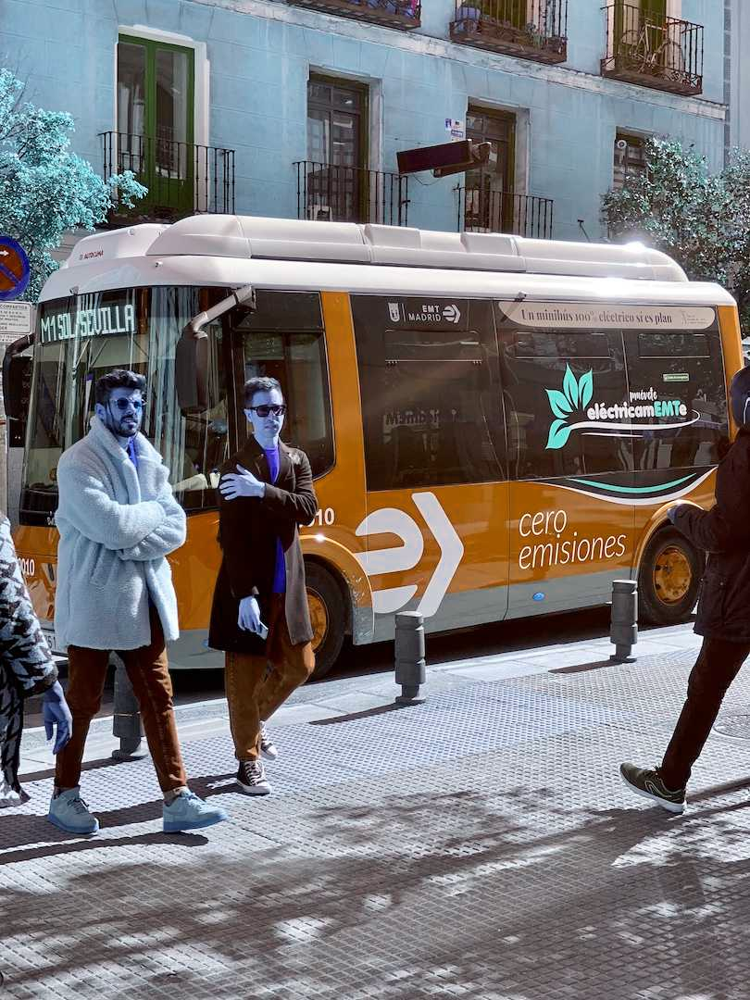

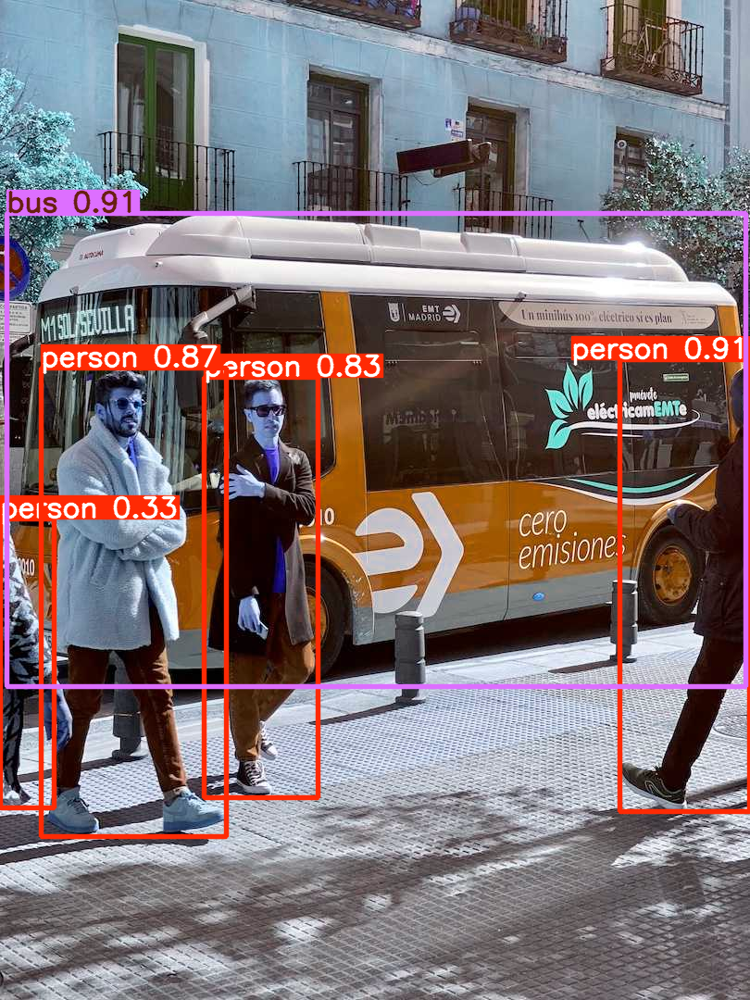

In [6]:
# YOLO12 inference in Jupyter Notebook
from ultralytics import YOLO
from IPython.display import display
from PIL import Image

# 1️⃣ Load the YOLO12 nano model
model = YOLO("yolo12n.pt")

# 2️⃣ Run inference on an image
results = model("https://ultralytics.com/images/bus.jpg")  # you can replace with a local file

# 3️⃣ Get the first result (only one image here)
r = results[0]

# 4️⃣ Show image inline (Jupyter)
im = Image.fromarray(r.orig_img)
display(im)

# 5️⃣ Access detected boxes, scores, and class names
boxes = r.boxes.xyxy.cpu().numpy()      # [x1, y1, x2, y2]
scores = r.boxes.conf.cpu().numpy()     # confidence
class_ids = r.boxes.cls.cpu().numpy()   # class index
class_names = [r.names[int(c)] for c in class_ids]

# 6️⃣ Print nicely
import pandas as pd

df = pd.DataFrame({
    "class": class_names,
    "score": scores,
    "x1": boxes[:,0],
    "y1": boxes[:,1],
    "x2": boxes[:,2],
    "y2": boxes[:,3]
})

# Draw predictions on image
r.plot()  # returns a numpy array with boxes drawn

# Show it inline
display(Image.fromarray(r.plot()))




Found https://ultralytics.com/images/bus.jpg locally at bus.jpg
image 1/1 /localhome/morne/yolo/scripts/bus.jpg: 640x480 4 persons, 1 bus, 3.5ms
Speed: 0.8ms preprocess, 3.5ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 480)


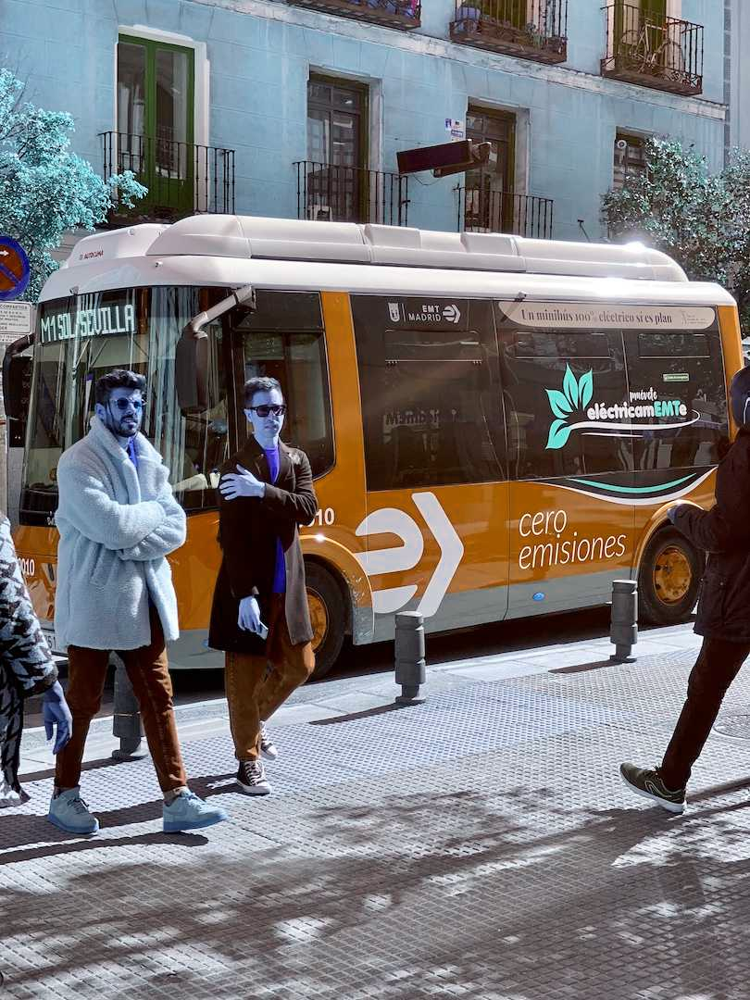

No masks detected.


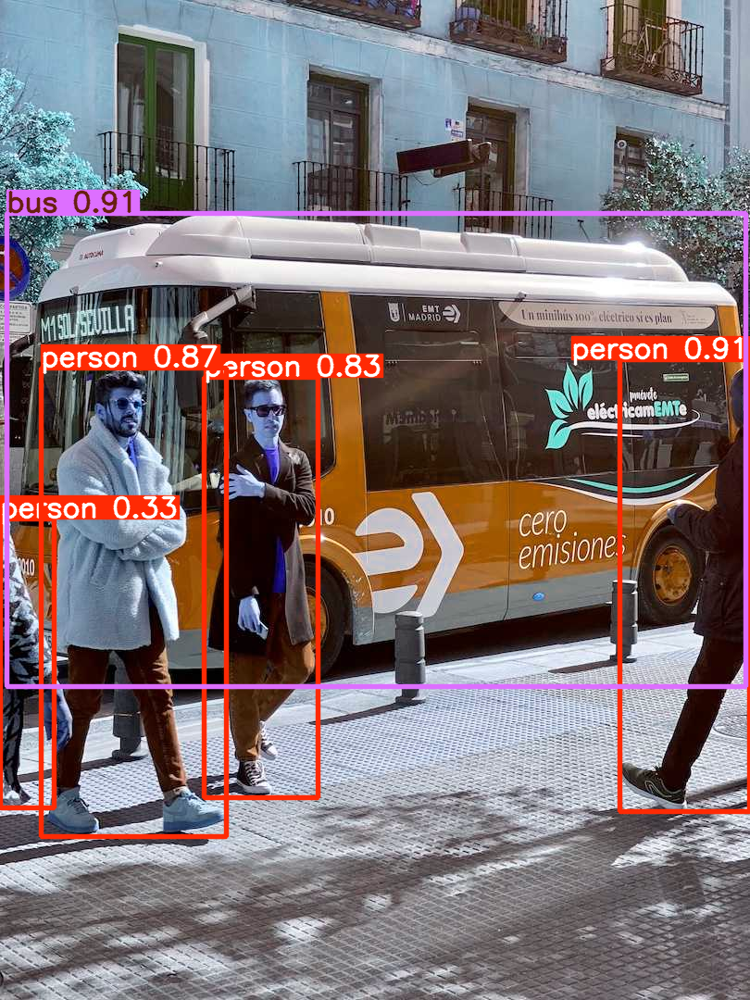

In [9]:
# YOLO12 segmentation in Jupyter Notebook
from ultralytics import YOLO
from PIL import Image
from IPython.display import display
import pandas as pd

# 1️⃣ Load a segmentation-capable YOLO12 model
# Use the "-seg" weights if you have them (YOLO12n-seg.pt), otherwise standard weights support segmentation as well
model = YOLO("yolo12n.pt")  # detection weights
results = model("https://ultralytics.com/images/bus.jpg", task="segment")


# 3️⃣ Get first result
r = results[0]

# 4️⃣ Show the original image inline
display(Image.fromarray(r.orig_img))

# 5️⃣ Access segmentation masks
# r.masks is a Segmentation object (can convert to polygons or binary masks)
if r.masks is not None:
    print("Masks available!")
    # Get masks as a boolean numpy array [num_masks, height, width]
    masks = r.masks.data.cpu().numpy()
    print("Masks shape:", masks.shape)
else:
    print("No masks detected.")

# 6️⃣ Access boxes, class IDs, and confidence (same as detection)
boxes = r.boxes.xyxy.cpu().numpy()
scores = r.boxes.conf.cpu().numpy()
class_ids = r.boxes.cls.cpu().numpy()
class_names = [r.names[int(c)] for c in class_ids]

# 7️⃣ Create a table of objects
df = pd.DataFrame({
    "class": class_names,
    "score": scores,
    "x1": boxes[:,0],
    "y1": boxes[:,1],
    "x2": boxes[:,2],
    "y2": boxes[:,3]
})

# r.plot() automatically draws boxes + masks
segmented_image = r.plot()
display(Image.fromarray(segmented_image))



In [13]:
from ultralytics import YOLO

# Create a new segmentation model from YAML
model = YOLO("yolo11n-seg.yaml")

# Train on your segmentation dataset
results = model.train(data="coco8-seg.yaml", epochs=100, imgsz=640)


Ultralytics 8.3.246 🚀 Python-3.10.12 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 4090, 24111MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=coco8-seg.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-seg.yaml, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

In [14]:
# Save the trained model to a custom path
model.save("yolo11n-seg-trained.pt")



image 1/1 /localhome/morne/yolo/data/20251223_190746(0)(1).jpg: 640x480 1 dog, 1 cow, 2.6ms
Speed: 0.8ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 480)


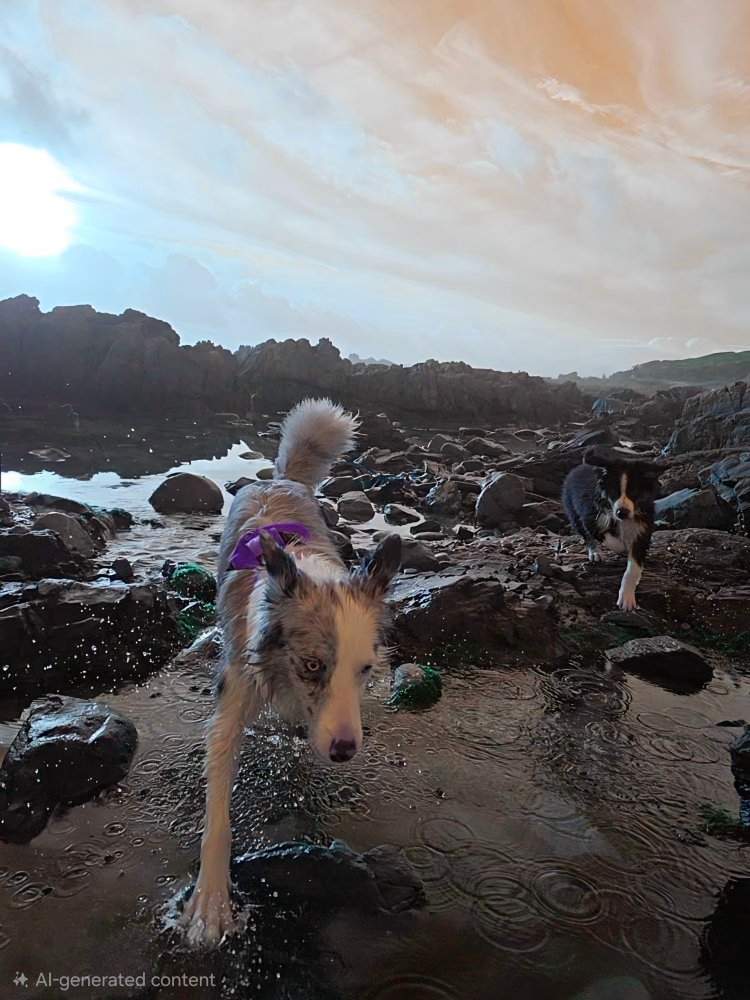

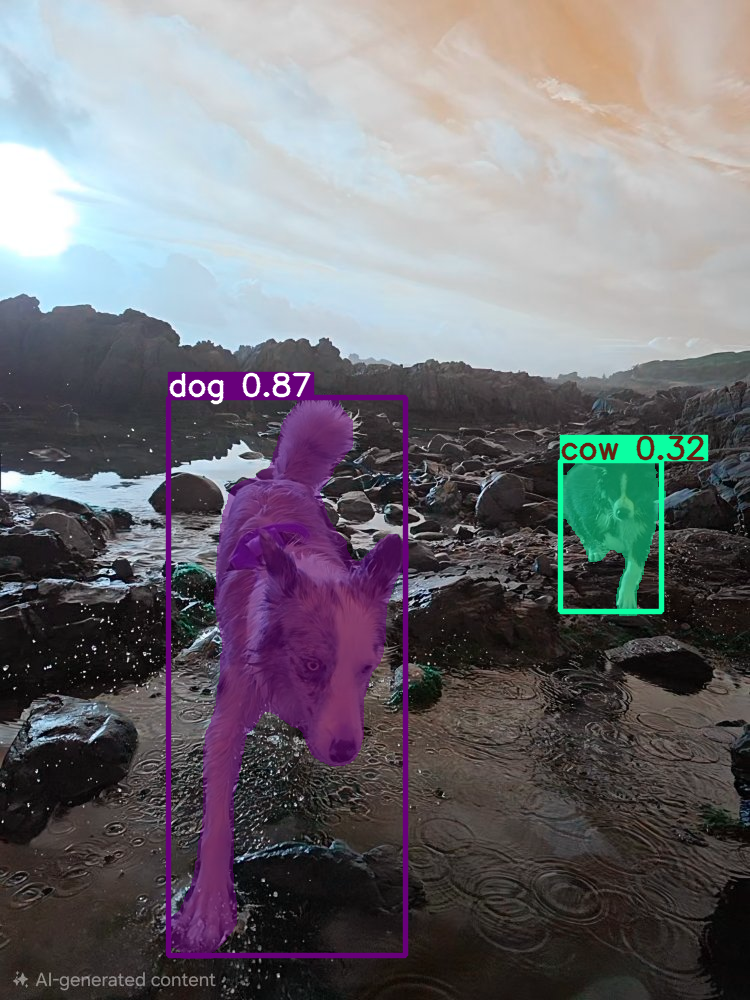

In [21]:
from ultralytics import YOLO
from PIL import Image
from IPython.display import display

model = YOLO("yolo11n-seg.pt")
results = model("/localhome/morne/yolo/data/20251223_190746(0)(1).jpg", task="segment")
r = results[0]

display(Image.fromarray(r.orig_img))
if r.masks is not None:
    display(Image.fromarray(r.plot()))


In [63]:
# -----------------------------
# YOLO11 Segmentation on Video (dog + person, filtered)
# -----------------------------
from ultralytics import YOLO
from IPython.display import Video
import os
import subprocess
import cv2
import numpy as np

# 1️⃣ Load model
model = YOLO("yolo11x-seg.pt")

# 2️⃣ Input video
input_video = "./data/20251223_190719.mp4"
if not os.path.exists(input_video):
    raise FileNotFoundError(f"Input video not found at {input_video}")

# 3️⃣ Run segmentation (YOLO outputs .avi)
results = model(
    input_video,
    task="segment",
    save=True,
    classes=[0, 16],  # person + dog
    conf=0.01
)

# 4️⃣ Class-specific thresholds
class_conf_thresholds = {
    0: 0.5,   # person
    16: 0.05   # dog
}

# 5️⃣ Get YOLO output AVI
yolo_output_dir = results[0].save_dir
avi_file = [f for f in os.listdir(yolo_output_dir) if f.endswith(".avi")][0]
avi_path = os.path.join(yolo_output_dir, avi_file)

# 6️⃣ Prepare output
cap = cv2.VideoCapture(avi_path)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

processed_dir = "./processed"
os.makedirs(processed_dir, exist_ok=True)
base_name = os.path.splitext(os.path.basename(input_video))[0]
processed_avi = os.path.join(processed_dir, f"{base_name}_seg.avi")
out = cv2.VideoWriter(processed_avi, cv2.VideoWriter_fourcc(*'XVID'), fps, (width, height))

# 7️⃣ Color map
color_map = {0: (0, 255, 0), 16: (0, 0, 255)}  # person=green, dog=red

# 8️⃣ Process each frame
for r in results:
    frame = r.orig_img.copy()
    annotated_frame = frame.copy()
    
    keep_indices = []
    if r.boxes is not None:
        for i, cls_id in enumerate(r.boxes.cls):
            cls_id = int(cls_id)
            conf = float(r.boxes.conf[i])
            if cls_id in class_conf_thresholds and conf >= class_conf_thresholds[cls_id]:
                keep_indices.append(i)
    
    # Apply masks properly
    if r.masks is not None:
        for i in keep_indices:
            mask = r.masks.data[i].cpu().numpy()  # mask shape (h_mask, w_mask)
            # Resize mask to match original frame
            mask_resized = cv2.resize(mask, (frame.shape[1], frame.shape[0]))  # width, height
            mask_bool = mask_resized > 0.5  # convert to boolean mask
            color = np.array(color_map[int(r.boxes.cls[i])], dtype=np.uint8)
            alpha = 0.5
            for c in range(3):  # apply mask to each channel
                annotated_frame[:, :, c] = np.where(mask_bool, 
                                                (1-alpha)*annotated_frame[:, :, c] + alpha*color[c], 
                                                annotated_frame[:, :, c])

    # Draw boxes
    if r.boxes is not None:
        for i in keep_indices:
            xyxy = r.boxes.xyxy[i].cpu().numpy().astype(int)
            cls_id = int(r.boxes.cls[i])
            label = r.names[cls_id]
            color = color_map[cls_id]
            cv2.rectangle(annotated_frame, tuple(xyxy[:2]), tuple(xyxy[2:]), color, 2)
            cv2.putText(annotated_frame, label, (xyxy[0], xyxy[1]-5),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    
    out.write(annotated_frame)

out.release()
cap.release()

# 9️⃣ Convert AVI -> MP4
mp4_path = processed_avi.replace(".avi", ".mp4")
ffmpeg_path = os.path.expanduser("~/bin/ffmpeg")
subprocess.run([ffmpeg_path, "-y", "-i", processed_avi, mp4_path], check=True)
os.remove(processed_avi)

print(f"Saved processed MP4: {mp4_path}")
Video(mp4_path, embed=True)



WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/105) /localhome/morne/yolo/data/20251223_190719.mp4: 640x480 (no detections), 22.9ms
video 1/1 (frame 2/105) /localhome/morne/yolo/data/20251223_190719.mp4: 640x480 (no detections), 16.1ms
video 1/1 (frame 3/105) /localhome/morne/yolo/data/20251223_190719.mp4: 640x480 (no detections), 16.1ms
video 1/1 (frame 4/105) /localhome/morne/yolo/data/20251223_190719.mp4: 640x480 1 person, 16.1ms
video 1/1 (frame 5/105) /localhome/morne/yolo/dat

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Saved processed MP4: ./processed/20251223_190719_seg.mp4


[out#0/mp4 @ 0xd696780] video:1835KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.099234%
frame=  105 fps=0.0 q=-1.0 Lsize=    1837KiB time=00:00:03.32 bitrate=4529.6kbits/s speed=6.37x    
[libx264 @ 0xd679f00] frame I:1     Avg QP:21.93  size: 65395
[libx264 @ 0xd679f00] frame P:60    Avg QP:22.73  size: 24408
[libx264 @ 0xd679f00] frame B:44    Avg QP:24.83  size:  7928
[libx264 @ 0xd679f00] consecutive B-frames: 40.0% 11.4%  2.9% 45.7%
[libx264 @ 0xd679f00] mb I  I16..4: 28.6% 70.2%  1.2%
[libx264 @ 0xd679f00] mb P  I16..4:  3.1% 13.7%  0.3%  P16..4: 49.7%  9.3%  6.0%  0.0%  0.0%    skip:17.9%
[libx264 @ 0xd679f00] mb B  I16..4:  0.9%  4.4%  0.1%  B16..8: 40.4%  3.2%  0.6%  direct: 1.7%  skip:48.6%  L0:51.0% L1:42.7% BI: 6.3%
[libx264 @ 0xd679f00] 8x8 transform intra:79.8% inter:79.1%
[libx264 @ 0xd679f00] coded y,uvDC,uvAC intra: 51.4% 60.8% 3.2% inter: 16.3% 17.2% 0.5%
[libx264 @ 0xd679f00] i16 v,h,dc,p: 23% 35% 28% 14%
[libx264 @ 0xd679f00]

In [85]:
# -----------------------------
# YOLO11 Segmentation on Video
# Filter person + dog and separate black dog vs other dog
# -----------------------------
from ultralytics import YOLO
from IPython.display import Video
import os
import subprocess
import cv2
import numpy as np

# 1️⃣ Load YOLO segmentation model
model = YOLO("yolo11x-seg.pt")

# 2️⃣ Input video
input_video = "./data/20251223_190325.mp4"
if not os.path.exists(input_video):
    raise FileNotFoundError(f"Input video not found at {input_video}")

# 3️⃣ Run segmentation WITHOUT saving to AVI
results = model(
    input_video,
    task="segment",
    save=False,  # DO NOT save automatically
    classes=[0, 16],  # person + dog
    conf=0.01         # very low, we filter manually
)

# 4️⃣ Class-specific thresholds
class_conf_thresholds = {
    0: 0.5,   # person
    16: 0.1   # dog
}

# 5️⃣ Prepare processed video writer
processed_dir = "./processed"
os.makedirs(processed_dir, exist_ok=True)
base_name = os.path.splitext(os.path.basename(input_video))[0]

cap = cv2.VideoCapture(input_video)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)
fourcc = cv2.VideoWriter_fourcc(*'XVID')
filtered_avi = os.path.join(processed_dir, f"{base_name}_filtered.avi")
out = cv2.VideoWriter(filtered_avi, fourcc, fps, (width, height))

# 6️⃣ Process frames
for frame_idx, r in enumerate(results):
    ret, frame = cap.read()
    if not ret:
        break

    annotated_frame = frame.copy()
    keep_indices = []

    if r.boxes is not None and r.masks is not None:
        # 6a️⃣ Filter boxes by confidence
        for i in range(len(r.boxes.cls)):
            cls_id = int(r.boxes.cls[i])
            conf = float(r.boxes.conf[i].item())
            if cls_id in class_conf_thresholds and conf >= class_conf_thresholds[cls_id]:
                keep_indices.append(i)

        # 6b️⃣ Draw filtered boxes and masks
        for i in keep_indices:
            cls_id = int(r.boxes.cls[i])
            mask = r.masks.data[i].cpu().numpy()
            if mask.shape[:2] != (frame.shape[0], frame.shape[1]):
                mask = cv2.resize(mask, (frame.shape[1], frame.shape[0]))
            mask_bool = mask > 0.5

            # Determine label
            if cls_id == 16:  # dog
                dog_pixels = frame[mask_bool]
                mean_intensity = dog_pixels.mean() if len(dog_pixels) > 0 else 255
                label = "Luke" if mean_intensity < 80 else "Layla"
            else:
                label = "person"

            # Colors
            color_map = {
                "person": (0, 255, 0),        # green
                "Luke": (255, 150, 0),      # soft sky blue
                "Layla": (255, 16, 240)      # baby pink
            }
            color = color_map[label]

            # Apply mask
            alpha = 0.5
            for c in range(3):
                annotated_frame[:, :, c] = np.where(
                    mask_bool,
                    (1-alpha)*annotated_frame[:, :, c] + alpha*color[c],
                    annotated_frame[:, :, c]
                )

            # Draw bounding box
            xyxy = r.boxes.xyxy[i].cpu().numpy().astype(int)
            cv2.rectangle(annotated_frame, (xyxy[0], xyxy[1]), (xyxy[2], xyxy[3]), color, 2)
            cv2.putText(
                annotated_frame,
                label,
                (xyxy[0], xyxy[1]-5),
                cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=1,   # bigger text
                color=color,
                thickness=2      # thicker line
            )


    out.write(annotated_frame)

cap.release()
out.release()

# 7️⃣ Convert to MP4
mp4_path = os.path.join(processed_dir, f"{base_name}_seg.mp4")
ffmpeg_path = os.path.expanduser("~/bin/ffmpeg")
subprocess.run([ffmpeg_path, "-y", "-i", filtered_avi, mp4_path], check=True)
print("Converted MP4 saved at:", mp4_path)

# 8️⃣ Delete intermediate AVI
os.remove(filtered_avi)

# 9️⃣ Display in Jupyter
Video(mp4_path, embed=True)



WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 23.0ms
video 1/1 (frame 2/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 3/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 4/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 5/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190325_seg.mp4


[out#0/mp4 @ 0xe10bf00] video:5404KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.034699%
frame=  107 fps=0.0 q=-1.0 Lsize=    5405KiB time=00:00:03.52 bitrate=12546.5kbits/s speed=4.86x    
[libx264 @ 0xe10cac0] frame I:3     Avg QP:24.81  size:101837
[libx264 @ 0xe10cac0] frame P:59    Avg QP:26.28  size: 55163
[libx264 @ 0xe10cac0] frame B:45    Avg QP:27.51  size: 43833
[libx264 @ 0xe10cac0] consecutive B-frames: 37.4% 11.2% 25.2% 26.2%
[libx264 @ 0xe10cac0] mb I  I16..4:  9.3% 86.3%  4.4%
[libx264 @ 0xe10cac0] mb P  I16..4:  3.6% 36.9%  3.9%  P16..4: 30.7% 12.3%  7.0%  0.0%  0.0%    skip: 5.6%
[libx264 @ 0xe10cac0] mb B  I16..4:  2.2% 22.3%  3.9%  B16..8: 33.2% 10.4%  2.4%  direct: 6.0%  skip:19.5%  L0:51.3% L1:33.6% BI:15.1%
[libx264 @ 0xe10cac0] 8x8 transform intra:81.8% inter:77.8%
[libx264 @ 0xe10cac0] coded y,uvDC,uvAC intra: 77.3% 61.4% 12.1% inter: 39.6% 27.7% 1.9%
[libx264 @ 0xe10cac0] i16 v,h,dc,p: 28% 39% 18% 15%
[libx264 @ 0xe10cac

In [ ]:
# -----------------------------
# YOLO11 Segmentation on Multiple Videos
# Filter person + dog and separate black dog vs other dog
# -----------------------------
from ultralytics import YOLO
from IPython.display import Video
import os
import subprocess
import cv2
import numpy as np

# 1️⃣ Load YOLO segmentation model
model = YOLO("yolo11x-seg.pt")

# 2️⃣ Folders
data_dir = "./data"
processed_dir = "./processed"
os.makedirs(processed_dir, exist_ok=True)

# 3️⃣ Class-specific thresholds
class_conf_thresholds = {
    0: 0.5,   # person
    16: 0.1   # dog
}

# 4️⃣ Loop over all MP4 videos in data folder
for input_video in sorted([f for f in os.listdir(data_dir) if f.endswith(".mp4")]):
    input_path = os.path.join(data_dir, input_video)
    base_name = os.path.splitext(input_video)[0]
    print(f"Processing video: {input_video}")

    # 5️⃣ Run segmentation
    results = model(
        input_path,
        task="segment",
        save=False,  # we filter manually
        classes=[0, 16],  # person + dog
        conf=0.01
    )

    # 6️⃣ Video capture and writer
    cap = cv2.VideoCapture(input_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    filtered_avi = os.path.join(processed_dir, f"{base_name}_filtered.avi")
    out = cv2.VideoWriter(filtered_avi, fourcc, fps, (width, height))

    # 7️⃣ Process frames
    for frame_idx, r in enumerate(results):
        ret, frame = cap.read()
        if not ret:
            break

        annotated_frame = frame.copy()
        keep_indices = []

        if r.boxes is not None and r.masks is not None:
            # 7a️⃣ Filter boxes by confidence
            for i in range(len(r.boxes.cls)):
                cls_id = int(r.boxes.cls[i])
                conf = float(r.boxes.conf[i].item())
                if cls_id in class_conf_thresholds and conf >= class_conf_thresholds[cls_id]:
                    keep_indices.append(i)

            # 7b️⃣ Draw filtered boxes and masks
            for i in keep_indices:
                cls_id = int(r.boxes.cls[i])
                mask = r.masks.data[i].cpu().numpy()
                if mask.shape[:2] != (frame.shape[0], frame.shape[1]):
                    mask = cv2.resize(mask, (frame.shape[1], frame.shape[0]))
                mask_bool = mask > 0.5

                # Determine label
                if cls_id == 16:  # dog
                    dog_pixels = frame[mask_bool]
                    mean_intensity = dog_pixels.mean() if len(dog_pixels) > 0 else 255
                    label = "Luke" if mean_intensity < 80 else "Layla"
                else:
                    label = "person"

                # Colors
                color_map = {
                    "person": (0, 255, 0),        # green
                    "Luke": (255, 150, 0),      # soft sky blue
                    "Layla": (255, 16, 240)      # baby pink
                }
                color = color_map[label]

                # Apply mask overlay
                alpha = 0.5
                for c in range(3):
                    annotated_frame[:, :, c] = np.where(
                        mask_bool,
                        (1-alpha)*annotated_frame[:, :, c] + alpha*color[c],
                        annotated_frame[:, :, c]
                    )

                # Draw bounding box
                xyxy = r.boxes.xyxy[i].cpu().numpy().astype(int)
                cv2.rectangle(annotated_frame, (xyxy[0], xyxy[1]), (xyxy[2], xyxy[3]), color, 2)

                # Draw label text (bigger)
                cv2.putText(
                    annotated_frame,
                    label,
                    (xyxy[0], xyxy[1]-5),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1,
                    color=color,
                    thickness=2
                )

        out.write(annotated_frame)

    cap.release()
    out.release()

    # 8️⃣ Convert filtered AVI -> MP4
    mp4_path = os.path.join(processed_dir, f"{base_name}_seg.mp4")
    ffmpeg_path = os.path.expanduser("~/bin/ffmpeg")
    subprocess.run([ffmpeg_path, "-y", "-i", filtered_avi, mp4_path], check=True)
    print(f"Converted MP4 saved at: {mp4_path}")

    # 9️⃣ Delete intermediate AVI
    os.remove(filtered_avi)

    # 10️⃣ Display in Jupyter for the last processed video only
Video(mp4_path, embed=True)


Processing video: 20251223_185458.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/103) /localhome/morne/yolo/data/20251223_185458.mp4: 640x480 1 person, 2 dogs, 22.8ms
video 1/1 (frame 2/103) /localhome/morne/yolo/data/20251223_185458.mp4: 640x480 1 person, 2 dogs, 16.0ms
video 1/1 (frame 3/103) /localhome/morne/yolo/data/20251223_185458.mp4: 640x480 1 person, 2 dogs, 16.0ms
video 1/1 (frame 4/103) /localhome/morne/yolo/data/20251223_185458.mp4: 640x480 1 person, 1 dog, 16.1ms
v

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_185458_seg.mp4
Processing video: 20251223_185921_1.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs



[out#0/mp4 @ 0xcc67f00] video:3783KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.037173%
frame=  103 fps=0.0 q=-1.0 Lsize=    3784KiB time=00:00:03.43 bitrate=9029.5kbits/s speed=   5x    
[libx264 @ 0xcc68980] frame I:1     Avg QP:23.34  size: 98259
[libx264 @ 0xcc68980] frame P:97    Avg QP:25.33  size: 38311
[libx264 @ 0xcc68980] frame B:5     Avg QP:27.68  size: 11735
[libx264 @ 0xcc68980] consecutive B-frames: 91.3%  5.8%  2.9%  0.0%
[libx264 @ 0xcc68980] mb I  I16..4: 21.5% 75.6%  2.9%
[libx264 @ 0xcc68980] mb P  I16..4:  2.3%  7.5%  0.9%  P16..4: 43.8% 20.6% 12.9%  0.0%  0.0%    skip:12.0%
[libx264 @ 0xcc68980] mb B  I16..4:  0.5%  1.6%  0.1%  B16..8: 45.1%  7.8%  1.4%  direct: 1.9%  skip:41.4%  L0:55.3% L1:26.4% BI:18.3%
[libx264 @ 0xcc68980] 8x8 transform intra:70.9% inter:68.9%
[libx264 @ 0xcc68980] coded y,uvDC,uvAC intra: 48.5% 59.6% 10.5% inter: 36.7% 27.2% 3.4%
[libx264 @ 0xcc68980] i16 v,h,dc,p: 34% 38% 22%  6%
[libx264 @ 0xcc68980

video 1/1 (frame 1/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 1 dog, 22.3ms
video 1/1 (frame 2/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 (no detections), 15.5ms
video 1/1 (frame 3/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 2 dogs, 15.7ms
video 1/1 (frame 4/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 3 dogs, 15.5ms
video 1/1 (frame 5/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 3 dogs, 15.4ms
video 1/1 (frame 6/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 1 dog, 15.5ms
video 1/1 (frame 7/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 1 dog, 15.6ms
video 1/1 (frame 8/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 1 dog, 15.5ms
video 1/1 (frame 9/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 3 dogs, 15.6ms
video 1/1 (frame 10/231) /localhome/morne/yolo/data/20251223_185921_1.mp4: 640x384 2 dogs, 15.4ms
video 1/1 (frame 11/231)

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_185921_1_seg.mp4
Processing video: 20251223_190322.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs



[out#0/mp4 @ 0xd5a4c00] video:10664KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.019369%
frame=  231 fps=142 q=-1.0 Lsize=   10666KiB time=00:00:07.64 bitrate=11435.0kbits/s speed=4.69x    
[libx264 @ 0xd5a5800] frame I:2     Avg QP:24.56  size: 79079
[libx264 @ 0xd5a5800] frame P:223   Avg QP:25.06  size: 47788
[libx264 @ 0xd5a5800] frame B:6     Avg QP:28.43  size: 17346
[libx264 @ 0xd5a5800] consecutive B-frames: 94.8%  5.2%  0.0%  0.0%
[libx264 @ 0xd5a5800] mb I  I16..4:  7.1% 90.9%  1.9%
[libx264 @ 0xd5a5800] mb P  I16..4:  0.7%  8.2%  0.8%  P16..4: 47.8% 14.9%  9.6%  0.0%  0.0%    skip:18.0%
[libx264 @ 0xd5a5800] mb B  I16..4:  0.5%  3.6%  0.2%  B16..8: 46.1%  4.7%  1.1%  direct: 2.5%  skip:41.2%  L0:51.5% L1:38.6% BI: 9.9%
[libx264 @ 0xd5a5800] 8x8 transform intra:84.9% inter:77.4%
[libx264 @ 0xd5a5800] coded y,uvDC,uvAC intra: 77.7% 59.1% 8.9% inter: 36.8% 16.3% 0.9%
[libx264 @ 0xd5a5800] i16 v,h,dc,p: 26% 33% 29% 12%
[libx264 @ 0xd5a580

video 1/1 (frame 1/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 3 dogs, 23.0ms
video 1/1 (frame 2/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 2 dogs, 16.2ms
video 1/1 (frame 3/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 3 dogs, 16.2ms
video 1/1 (frame 4/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 1 person, 3 dogs, 16.1ms
video 1/1 (frame 5/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 1 person, 2 dogs, 16.0ms
video 1/1 (frame 6/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 2 dogs, 16.1ms
video 1/1 (frame 7/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 3 persons, 2 dogs, 16.1ms
video 1/1 (frame 8/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 2 dogs, 16.0ms
video 1/1 (frame 9/95) /localhome/morne/yolo/data/20251223_190322.mp4: 640x480 2 persons, 2 dogs, 16.1ms
video 1/1 (frame 10/95) /localhome/morne/yolo/data/202512

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190322_seg.mp4
Processing video: 20251223_190324(0).mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs



[out#0/mp4 @ 0xe6f5e40] video:3882KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.045479%
frame=   95 fps=0.0 q=-1.0 Lsize=    3884KiB time=00:00:03.13 bitrate=10150.0kbits/s speed=5.17x    
[libx264 @ 0xe6f6a00] frame I:1     Avg QP:24.77  size: 89462
[libx264 @ 0xe6f6a00] frame P:48    Avg QP:25.47  size: 50494
[libx264 @ 0xe6f6a00] frame B:46    Avg QP:26.89  size: 31774
[libx264 @ 0xe6f6a00] consecutive B-frames: 32.6%  4.2% 12.6% 50.5%
[libx264 @ 0xe6f6a00] mb I  I16..4: 28.8% 68.2%  3.0%
[libx264 @ 0xe6f6a00] mb P  I16..4:  4.0% 24.4%  2.5%  P16..4: 37.6% 16.2%  8.9%  0.0%  0.0%    skip: 6.4%
[libx264 @ 0xe6f6a00] mb B  I16..4:  1.5% 10.8%  1.5%  B16..8: 39.8% 11.8%  3.4%  direct: 4.1%  skip:27.1%  L0:50.5% L1:34.1% BI:15.4%
[libx264 @ 0xe6f6a00] 8x8 transform intra:78.3% inter:76.1%
[libx264 @ 0xe6f6a00] coded y,uvDC,uvAC intra: 67.4% 52.3% 5.3% inter: 35.3% 22.2% 1.6%
[libx264 @ 0xe6f6a00] i16 v,h,dc,p: 32% 36% 19% 13%
[libx264 @ 0xe6f6a00

video 1/1 (frame 1/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.1ms
video 1/1 (frame 2/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.0ms
video 1/1 (frame 3/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.1ms
video 1/1 (frame 4/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.2ms
video 1/1 (frame 5/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 6/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.0ms
video 1/1 (frame 7/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.1ms
video 1/1 (frame 8/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 5 dogs, 16.0ms
video 1/1 (frame 9/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.1ms
video 1/1 (frame 10/100) /localhome/morne/yolo/data/20251223_190324(0).mp4: 640x480 2 dogs, 16.0ms
video 1/1 (frame 11/

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190324(0)_seg.mp4
Processing video: 20251223_190324.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs



[out#0/mp4 @ 0xcb73fc0] video:4472KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.038520%
frame=  100 fps=0.0 q=-1.0 Lsize=    4474KiB time=00:00:03.30 bitrate=11094.7kbits/s speed=5.04x    
[libx264 @ 0xcb74bc0] frame I:1     Avg QP:24.67  size: 73661
[libx264 @ 0xcb74bc0] frame P:66    Avg QP:25.48  size: 49503
[libx264 @ 0xcb74bc0] frame B:33    Avg QP:27.13  size: 37512
[libx264 @ 0xcb74bc0] consecutive B-frames: 52.0% 10.0%  6.0% 32.0%
[libx264 @ 0xcb74bc0] mb I  I16..4: 23.4% 74.0%  2.6%
[libx264 @ 0xcb74bc0] mb P  I16..4:  3.6% 22.8%  2.9%  P16..4: 38.0% 16.0%  9.3%  0.0%  0.0%    skip: 7.4%
[libx264 @ 0xcb74bc0] mb B  I16..4:  2.1% 14.7%  3.6%  B16..8: 37.2% 10.6%  2.8%  direct: 4.0%  skip:25.1%  L0:48.0% L1:37.2% BI:14.8%
[libx264 @ 0xcb74bc0] 8x8 transform intra:76.4% inter:74.2%
[libx264 @ 0xcb74bc0] coded y,uvDC,uvAC intra: 68.0% 55.9% 6.4% inter: 36.4% 24.8% 0.8%
[libx264 @ 0xcb74bc0] i16 v,h,dc,p: 24% 42% 21% 13%
[libx264 @ 0xcb74bc0

video 1/1 (frame 1/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.0ms
video 1/1 (frame 2/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.0ms
video 1/1 (frame 3/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 4/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 5/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 6/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 7/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 2 dogs, 16.2ms
video 1/1 (frame 8/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 3 dogs, 16.0ms
video 1/1 (frame 9/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 3 dogs, 16.2ms
video 1/1 (frame 10/101) /localhome/morne/yolo/data/20251223_190324.mp4: 640x480 3 dogs, 16.1ms
video 1/1 (frame 11/101) /localhome/morne/yolo/data/202

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190324_seg.mp4
Processing video: 20251223_190325.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs



[out#0/mp4 @ 0xe4affc0] video:4045KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.041139%
frame=  101 fps=0.0 q=-1.0 Lsize=    4047KiB time=00:00:03.33 bitrate=9934.0kbits/s speed=5.15x    
[libx264 @ 0xe4b0b80] frame I:1     Avg QP:23.94  size: 78977
[libx264 @ 0xe4b0b80] frame P:68    Avg QP:25.19  size: 45771
[libx264 @ 0xe4b0b80] frame B:32    Avg QP:26.84  size: 29687
[libx264 @ 0xe4b0b80] consecutive B-frames: 53.5%  5.9% 20.8% 19.8%
[libx264 @ 0xe4b0b80] mb I  I16..4: 19.0% 78.5%  2.5%
[libx264 @ 0xe4b0b80] mb P  I16..4:  3.5% 20.7%  2.3%  P16..4: 42.3% 14.7%  8.8%  0.0%  0.0%    skip: 7.6%
[libx264 @ 0xe4b0b80] mb B  I16..4:  1.5% 10.5%  2.1%  B16..8: 40.3% 10.1%  2.6%  direct: 3.5%  skip:29.4%  L0:53.5% L1:32.2% BI:14.3%
[libx264 @ 0xe4b0b80] 8x8 transform intra:77.3% inter:75.2%
[libx264 @ 0xe4b0b80] coded y,uvDC,uvAC intra: 66.1% 55.8% 5.3% inter: 35.5% 23.8% 0.8%
[libx264 @ 0xe4b0b80] i16 v,h,dc,p: 25% 41% 25% 10%
[libx264 @ 0xe4b0b80]

video 1/1 (frame 1/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 2/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 3/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 4/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 5/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 6/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 7/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.2ms
video 1/1 (frame 8/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 9/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.3ms
video 1/1 (frame 10/107) /localhome/morne/yolo/data/20251223_190325.mp4: 640x480 1 dog, 16.1ms
video 1/1 (frame 11/107) /localhome/morne/yolo/data/2025122

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190325_seg.mp4
Processing video: 20251223_190418.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.1ms
video 1/1 (frame 2/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.0ms


[out#0/mp4 @ 0xd658f00] video:5331KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.034804%
frame=  107 fps=0.0 q=-1.0 Lsize=    5333KiB time=00:00:03.52 bitrate=12378.5kbits/s speed=4.89x    
[libx264 @ 0xd659ac0] frame I:3     Avg QP:24.81  size:101608
[libx264 @ 0xd659ac0] frame P:61    Avg QP:26.31  size: 53923
[libx264 @ 0xd659ac0] frame B:43    Avg QP:27.56  size: 43357
[libx264 @ 0xd659ac0] consecutive B-frames: 40.2%  9.3% 28.0% 22.4%
[libx264 @ 0xd659ac0] mb I  I16..4:  9.3% 86.3%  4.4%
[libx264 @ 0xd659ac0] mb P  I16..4:  3.6% 34.6%  4.0%  P16..4: 32.3% 12.8%  7.1%  0.0%  0.0%    skip: 5.6%
[libx264 @ 0xd659ac0] mb B  I16..4:  2.4% 23.0%  3.9%  B16..8: 32.1% 10.5%  2.6%  direct: 5.9%  skip:19.7%  L0:49.5% L1:36.2% BI:14.2%
[libx264 @ 0xd659ac0] 8x8 transform intra:81.2% inter:77.3%
[libx264 @ 0xd659ac0] coded y,uvDC,uvAC intra: 76.8% 61.1% 10.7% inter: 40.2% 27.8% 1.0%
[libx264 @ 0xd659ac0] i16 v,h,dc,p: 28% 40% 18% 15%
[libx264 @ 0xd659ac

video 1/1 (frame 3/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.0ms
video 1/1 (frame 4/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.1ms
video 1/1 (frame 5/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.0ms
video 1/1 (frame 6/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.1ms
video 1/1 (frame 7/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.0ms
video 1/1 (frame 8/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.1ms
video 1/1 (frame 9/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.2ms
video 1/1 (frame 10/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.2ms
video 1/1 (frame 11/104) /localhome/morne/yolo/data/20251223_190418.mp4: 640x480 1 person, 1 dog, 16.0ms
video 1/1 (frame 12/104) /localhome/morne/yolo/data/20251223_1

In [3]:
import os
data_dir = "./data"
sorted([f for f in os.listdir(data_dir) if f.endswith(".mp4")])

['20251223_185458.mp4',
 '20251223_185921_1.mp4',
 '20251223_190322.mp4',
 '20251223_190324(0).mp4',
 '20251223_190324.mp4',
 '20251223_190325.mp4',
 '20251223_190418.mp4',
 '20251223_190427.mp4',
 '20251223_190428.mp4',
 '20251223_190458.mp4',
 '20251223_190648.mp4',
 '20251223_190649.mp4',
 '20251223_190719(0).mp4',
 '20251223_190719.mp4',
 '20251223_190725(0).mp4',
 '20251223_190729(0).mp4',
 '20251223_190746(0)(1).mp4',
 '20251223_190746(0).mp4',
 '20251223_190747.mp4']

In [7]:
# -----------------------------
# YOLO11 Segmentation on Multiple Videos
# Filter person + dog and separate black dog vs other dog
# -----------------------------
from ultralytics import YOLO
from IPython.display import Video
import os
import subprocess
import cv2
import numpy as np

# 1️⃣ Load YOLO segmentation model
model = YOLO("yolo11x-seg.pt")

# 2️⃣ Folders
data_dir = "./data"
processed_dir = "./processed"
os.makedirs(processed_dir, exist_ok=True)

# 3️⃣ Class-specific thresholds
class_conf_thresholds = {
    0: 0.5,   # person
    16: 0.01   # dog
}

# 4️⃣ Loop over all MP4 videos in data folder
for input_video in ['20251223_190458.mp4',]: #sorted([f for f in os.listdir(data_dir) if f.endswith(".mp4")]):
    input_path = os.path.join(data_dir, input_video)
    base_name = os.path.splitext(input_video)[0]
    print(f"Processing video: {input_video}")

    # 5️⃣ Run segmentation
    results = model(
        input_path,
        task="segment",
        save=False,  # we filter manually
        classes=[0, 16],  # person + dog
        conf=0.001
    )

    # 6️⃣ Video capture and writer
    cap = cv2.VideoCapture(input_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    filtered_avi = os.path.join(processed_dir, f"{base_name}_filtered.avi")
    out = cv2.VideoWriter(filtered_avi, fourcc, fps, (width, height))

    # 7️⃣ Process frames
    for frame_idx, r in enumerate(results):
        ret, frame = cap.read()
        if not ret:
            break

        annotated_frame = frame.copy()
        keep_indices = []

        if r.boxes is not None and r.masks is not None:
            # 7a️⃣ Filter boxes by confidence
            for i in range(len(r.boxes.cls)):
                cls_id = int(r.boxes.cls[i])
                conf = float(r.boxes.conf[i].item())
                if cls_id in class_conf_thresholds and conf >= class_conf_thresholds[cls_id]:
                    keep_indices.append(i)

            # 7b️⃣ Draw filtered boxes and masks
            for i in keep_indices:
                cls_id = int(r.boxes.cls[i])
                mask = r.masks.data[i].cpu().numpy()
                if mask.shape[:2] != (frame.shape[0], frame.shape[1]):
                    mask = cv2.resize(mask, (frame.shape[1], frame.shape[0]))
                mask_bool = mask > 0.01

                # Determine label
                if cls_id == 16:  # dog
                    dog_pixels = frame[mask_bool]
                    mean_intensity = dog_pixels.mean() if len(dog_pixels) > 0 else 255
                    label = "Luke" if mean_intensity < 60 else "Layla"
                else:
                    label = "person"

                # Colors
                color_map = {
                    "person": (0, 255, 0),        # green
                    "Luke": (255, 150, 0),      # soft sky blue
                    "Layla": (255, 16, 240)      # baby pink
                }
                color = color_map[label]

                # Apply mask overlay
                alpha = 0.5
                for c in range(3):
                    annotated_frame[:, :, c] = np.where(
                        mask_bool,
                        (1-alpha)*annotated_frame[:, :, c] + alpha*color[c],
                        annotated_frame[:, :, c]
                    )

                # Draw bounding box
                xyxy = r.boxes.xyxy[i].cpu().numpy().astype(int)
                cv2.rectangle(annotated_frame, (xyxy[0], xyxy[1]), (xyxy[2], xyxy[3]), color, 2)

                # Draw label text (bigger)
                cv2.putText(
                    annotated_frame,
                    label,
                    (xyxy[0], xyxy[1]-5),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1,
                    color=color,
                    thickness=2
                )

        out.write(annotated_frame)

    cap.release()
    out.release()

    # 8️⃣ Convert filtered AVI -> MP4
    mp4_path = os.path.join(processed_dir, f"{base_name}_seg.mp4")
    ffmpeg_path = os.path.expanduser("~/bin/ffmpeg")
    subprocess.run([ffmpeg_path, "-y", "-i", filtered_avi, mp4_path], check=True)
    print(f"Converted MP4 saved at: {mp4_path}")

    # 9️⃣ Delete intermediate AVI
    os.remove(filtered_avi)

    # 10️⃣ Display in Jupyter for the last processed video only
Video(mp4_path, embed=True)


Processing video: 20251223_190458.mp4

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/108) /localhome/morne/yolo/data/20251223_190458.mp4: 640x480 2 dogs, 7.8ms
video 1/1 (frame 2/108) /localhome/morne/yolo/data/20251223_190458.mp4: 640x480 2 dogs, 7.5ms
video 1/1 (frame 3/108) /localhome/morne/yolo/data/20251223_190458.mp4: 640x480 1 person, 3 dogs, 7.5ms
video 1/1 (frame 4/108) /localhome/morne/yolo/data/20251223_190458.mp4: 640x480 4 dogs, 7.5ms
video 1/1 (frame 5/108) /localhome

ffmpeg version 7.0.2-static https://johnvansickle.com/ffmpeg/  Copyright (c) 2000-2024 the FFmpeg developers
  built with gcc 8 (Debian 8.3.0-6)
  configuration: --enable-gpl --enable-version3 --enable-static --disable-debug --disable-ffplay --disable-indev=sndio --disable-outdev=sndio --cc=gcc --enable-fontconfig --enable-frei0r --enable-gnutls --enable-gmp --enable-libgme --enable-gray --enable-libfribidi --enable-libass --enable-libfreetype --enable-libmp3lame --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-librubberband --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libvorbis --enable-libopus --enable-libtheora --enable-libvidstab --enable-libvo-amrwbenc --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg
  libavutil      59.  8.100 / 59.  8.100
  libavcodec     61.  3.100 / 61.  3.100
  libavformat    61.  1.100 / 61.  1.100
  libavdevice    61.  1.100 / 61.  1.100
  

Converted MP4 saved at: ./processed/20251223_190458_seg.mp4


[out#0/mp4 @ 0xd8dce00] video:3550KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: 0.054464%
frame=  108 fps=0.0 q=-1.0 Lsize=    3552KiB time=00:00:03.21 bitrate=9059.1kbits/s speed=5.44x    
[libx264 @ 0xd880c40] frame I:1     Avg QP:25.54  size:139487
[libx264 @ 0xd880c40] frame P:55    Avg QP:24.79  size: 51489
[libx264 @ 0xd880c40] frame B:52    Avg QP:27.97  size: 12757
[libx264 @ 0xd880c40] consecutive B-frames: 30.6%  7.4% 25.0% 37.0%
[libx264 @ 0xd880c40] mb I  I16..4: 23.9% 73.8%  2.2%
[libx264 @ 0xd880c40] mb P  I16..4:  2.0% 10.5%  1.1%  P16..4: 42.8% 17.7% 13.0%  0.0%  0.0%    skip:13.0%
[libx264 @ 0xd880c40] mb B  I16..4:  0.5%  2.7%  0.5%  B16..8: 41.1%  6.2%  1.5%  direct: 2.3%  skip:45.2%  L0:49.3% L1:30.7% BI:20.0%
[libx264 @ 0xd880c40] 8x8 transform intra:76.4% inter:71.2%
[libx264 @ 0xd880c40] coded y,uvDC,uvAC intra: 57.5% 69.0% 15.5% inter: 26.8% 20.0% 2.2%
[libx264 @ 0xd880c40] i16 v,h,dc,p: 28% 34% 26% 12%
[libx264 @ 0xd880c40